# Imports

In [1]:
import numpy as np
import math
import cv2
import glob
import matplotlib.pyplot as plt
from IPython.display import Video

In [2]:
# Get input video paths
videos = glob.glob("data/medium/*.MOV")

# Board detection using key-point homography

## Initialize detector, descriptor and matcher

In [3]:
sift = cv2.SIFT_create()
index_params = dict(algorithm = 0, trees = 5)
search_params = dict()
flann = cv2.FlannBasedMatcher(index_params, search_params)

## Board template image

Load the in grayscale, compute it's key-points and their descriptions:

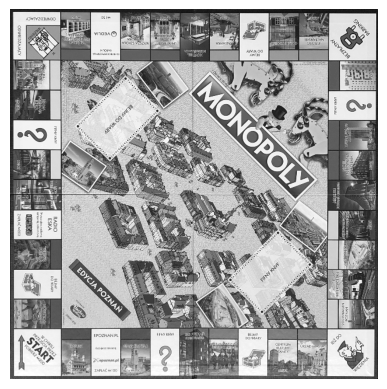

In [4]:
board = cv2.imread("data/train/board.JPG", cv2.IMREAD_GRAYSCALE)
board = cv2.resize(board, None, fx=0.25, fy=0.25)

plt.axis('off')
plt.imshow(board, cmap='gray')

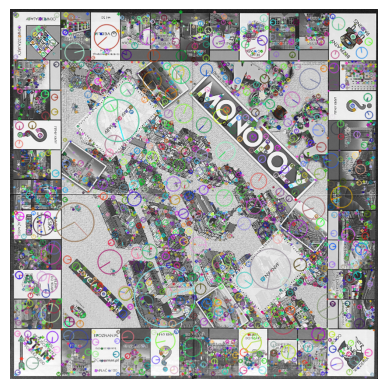

In [5]:
kpBoard, descBoard = sift.detectAndCompute(board, None)

img = cv2.drawKeypoints(board, kpBoard, None, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.axis('off')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

## Board on video

Read the 1st frame, convert it to grayscale, compute it's key-points and their descriptions:

In [6]:
cap = cv2.VideoCapture(videos[0])
success, frame = cap.read()
cap.release()

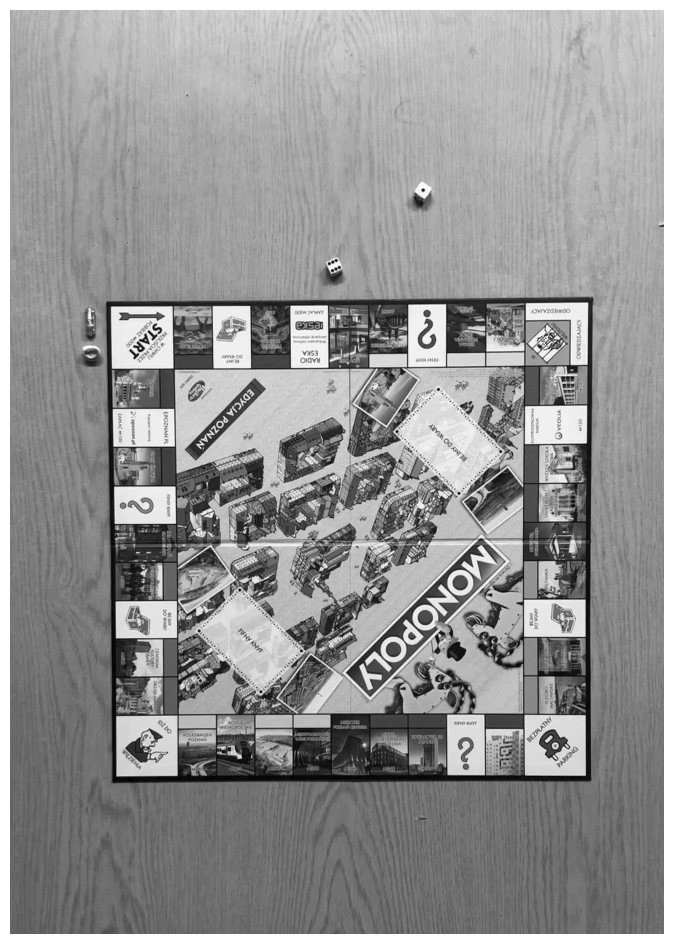

In [7]:
frameGray = cv2.cvtColor(frame, cv2.COLOR_BGR2GRAY)

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(frameGray, cmap='gray')

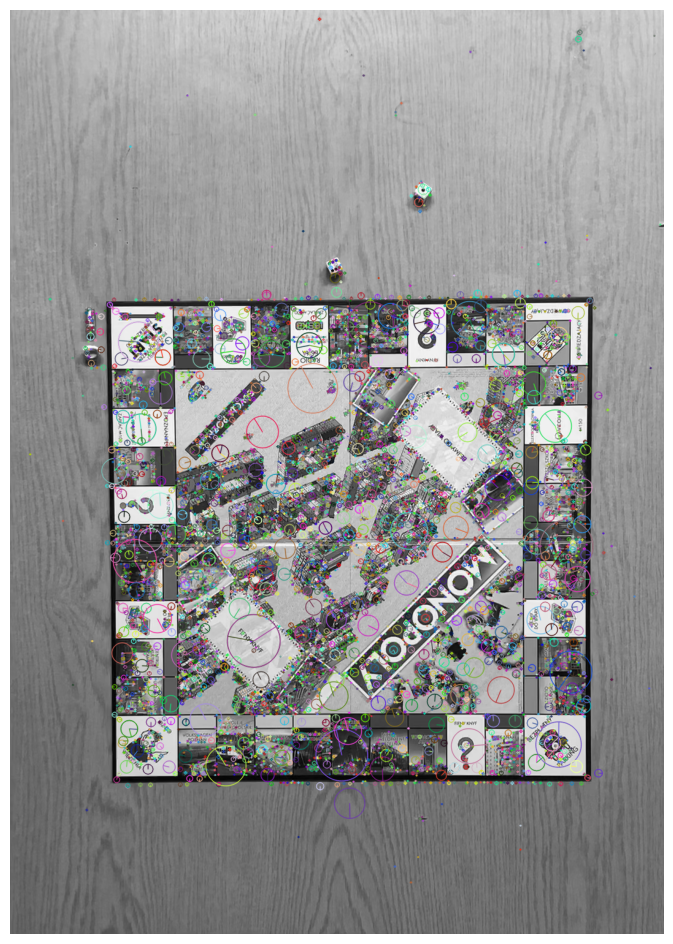

In [8]:
kpFrameFray, descFrameGray = sift.detectAndCompute(frameGray, None)

img = cv2.drawKeypoints(frameGray, kpFrameFray, None, flags = cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

# Key-point matching

Find all matches, extract 'good' ones:

In [9]:
matches = flann.knnMatch(descBoard, descFrameGray, k = 2)

In [10]:
queryPts = []
trainPts = []
for m, n in matches:
    if m.distance < 0.5 * n.distance:
        queryPts.append(kpBoard[m.queryIdx].pt)
        trainPts.append(kpFrameFray[m.trainIdx].pt)
queryPts = np.float32(queryPts)[:, np.newaxis, :]
trainPts = np.float32(trainPts)[:, np.newaxis, :]

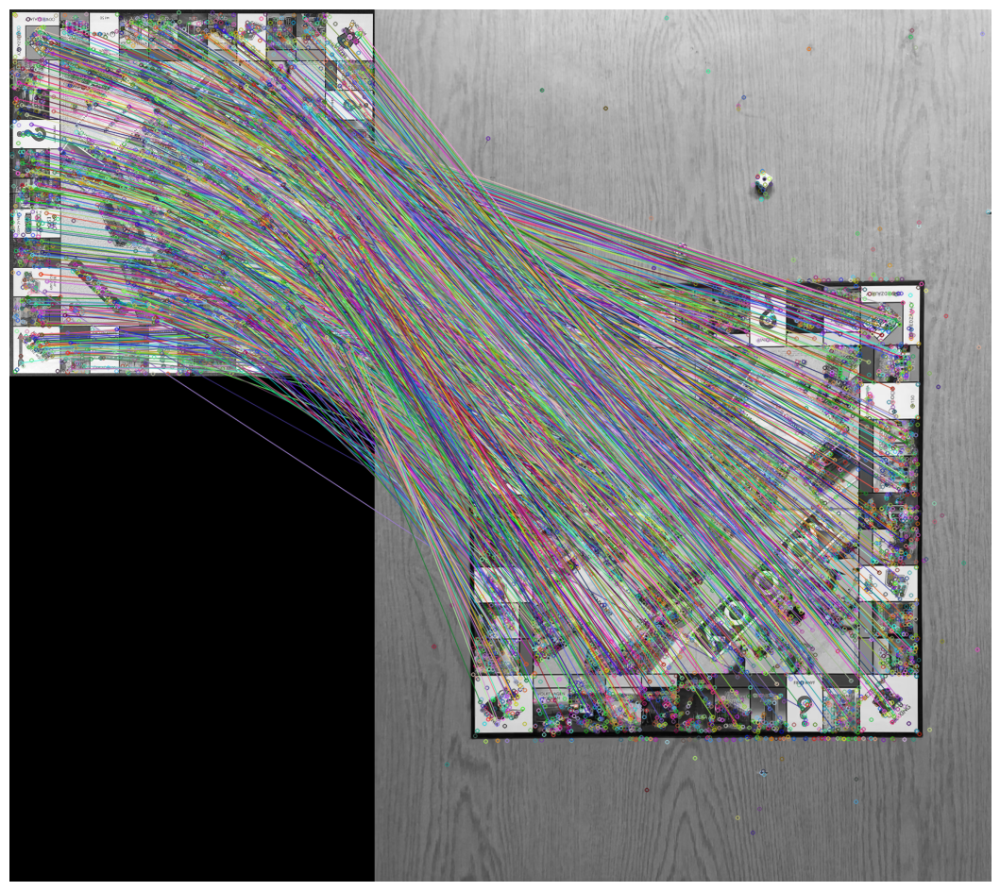

In [11]:
# Demo
goodPoints = []
for m, n in matches:
    if m.distance < 0.5 * n.distance:
        goodPoints.append(m)
        
img = cv2.drawMatches(board, kpBoard, frameGray, kpFrameFray, goodPoints, frameGray)

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

## Homography

In [12]:
matrix, _ = cv2.findHomography(queryPts, trainPts, cv2.RANSAC, 5.0)

## Transform the perspective

By finding the trasformataion matrix, we can get the exact coordinated of the board on video:

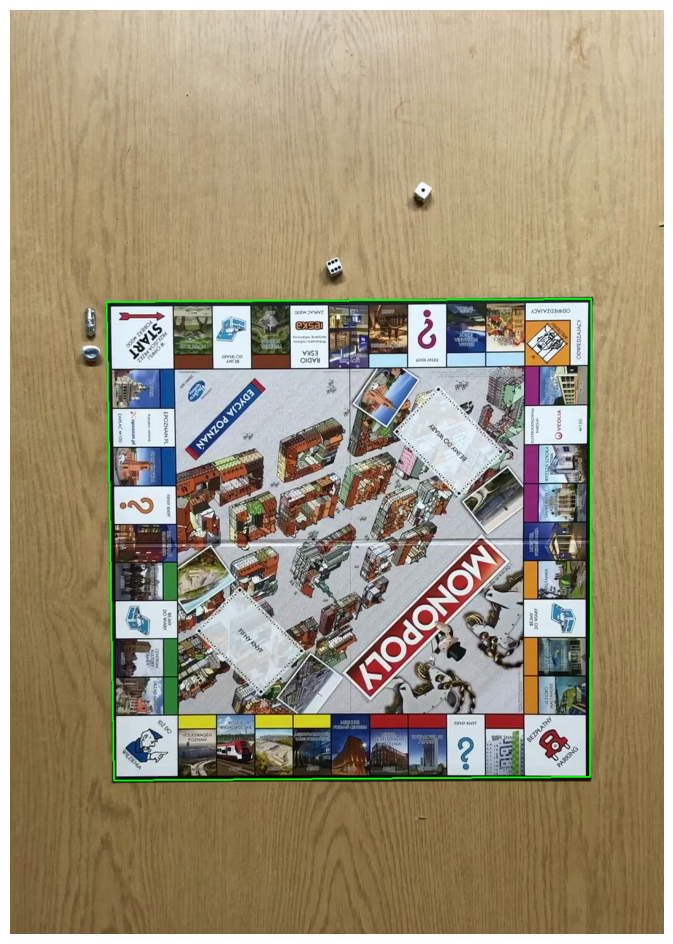

In [13]:
# Get template dimentions
h, w = board.shape
templateDims = np.float32([[0, 0], [0, h], [w, h], [w, 0]])[:, np.newaxis, :]

boardCoords = np.int32(cv2.perspectiveTransform(templateDims, matrix))

cv2.polylines(frame, [boardCoords], True, (0, 255, 0), 2)

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(cv2.cvtColor(frame, cv2.COLOR_BGR2RGB))

# Working with the detected board only

We can create a mask which will show only the detected board:

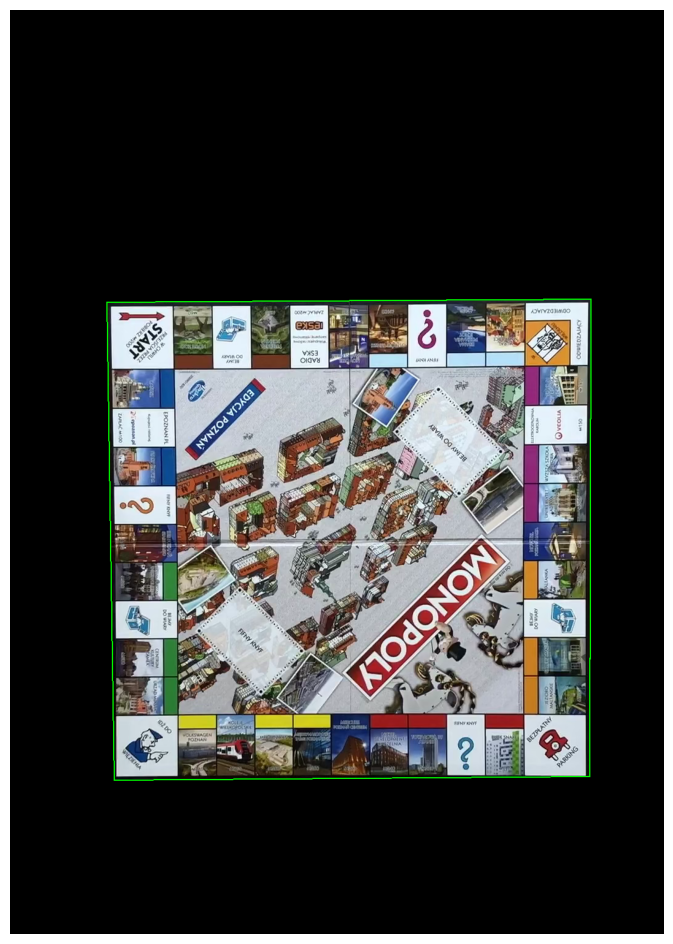

In [14]:
# Extract the board from a frame
boardMask = np.zeros(frame.shape[:2])
cv2.fillConvexPoly(boardMask, boardCoords, 1)
boardMask = boardMask.astype(bool)

img = np.zeros_like(frame)
img[boardMask] = frame[boardMask]

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

It will be pretty hard to work with the exact shape, so we can get a bounding rectange of it:

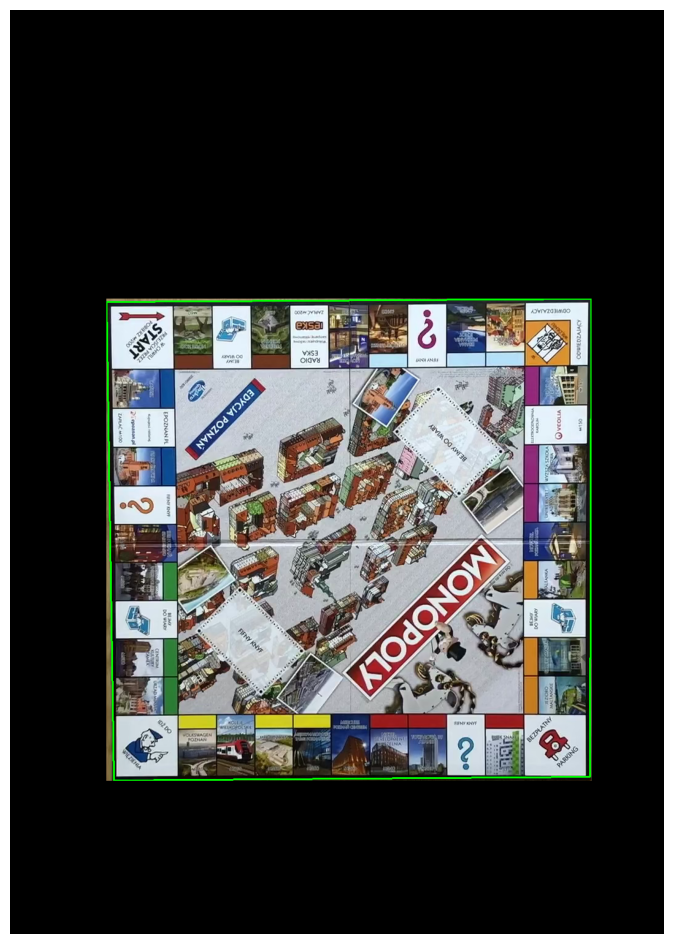

In [15]:
roiBBox = cv2.boundingRect(boardCoords)

extractedBoard = frame[roiBBox[1]: roiBBox[1]+roiBBox[3], roiBBox[0]: roiBBox[0]+roiBBox[2]]
img = np.zeros_like(frame)
img[roiBBox[1]: roiBBox[1]+roiBBox[3], roiBBox[0]: roiBBox[0]+roiBBox[2]] = extractedBoard

fig = plt.figure(figsize=(16, 12))
plt.axis('off')
plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))

# Moving object detection

In [16]:
class ObjectDetector:
    def __init__(self):
        self.movementDetector = cv2.createBackgroundSubtractorKNN(history = 1000, dist2Threshold = 1500, detectShadows = False)
        self.kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (7, 7))

    def getDetections(self, roi):
        mask = self.movementDetector.apply(roi)
        mask = cv2.GaussianBlur(mask, (3, 3), cv2.BORDER_DEFAULT)
        
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, self.kernel)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN, self.kernel)
        _, mask = cv2.threshold(mask, 200, 255, cv2.THRESH_BINARY)
        
        contours, _ = cv2.findContours(mask, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

        detections = []
        for cnt in contours:
            # Calculate area and remove too small or too big elements
            area = cv2.contourArea(cnt)
            if 500 < area < 1400:
                x, y, w, h = cv2.boundingRect(cnt)
                detections.append([x, y, w, h])
        return detections

In [17]:
intermediate = glob.glob("output/intermediate/objectDetection/*.mp4")

We can detect moving objects in ROI by:
1. getting a mask with applying a backgroud substractor
2. blurring a bit

In [18]:
# Demo
Video(intermediate[0], embed = True)

3. applying mopphology
4. thresholding

In [19]:
# Demo
Video(intermediate[1], embed = True)

5. getting the contours of white spots

Then we can filter unappropriate area countours.

# Object recognition

In [20]:
class ObjectInitilizer:
    def __init__(self):
        self.centerPoints = {}
        self.idCounter = 0
        self.frameCounts = dict()

    def update(self, detections):
        # Currently detected objects
        objects = []
        for bbox in detections:
            x, y, w, h = bbox
            # Get center point of new object
            cx = (x + x + w) // 2
            cy = (y + y + h) // 2
            # Check if it has been alredy detected
            alreadyDetected = False
            for objID, pt in self.centerPoints.items():
                dist = math.hypot(cx - pt[0], cy - pt[1])
                if dist < 70:
                    self.centerPoints[objID] = (cx, cy)
                    self.frameCounts[objID] += 1 
                    objects.append([x, y, w, h, objID, self.frameCounts[objID]])
                    alreadyDetected = True
                    break
            # New object detected
            if not alreadyDetected:
                self.centerPoints[self.idCounter] = (cx, cy)
                self.frameCounts[self.idCounter] = 1
                objects.append([x, y, w, h, self.idCounter, 1])
                self.idCounter += 1
        # Clean the currently undetected objects
        currentCenterPoints = {}
        curentframeCounts = {}
        for detection in objects:
            _, _, _, _, objID, frameCount = detection
            currentCenterPoints[objID] = self.centerPoints[objID]
            curentframeCounts[objID] = frameCount

        # Clean dictionaries with not used IDs
        self.centerPoints = currentCenterPoints.copy()
        self.frameCounts = curentframeCounts.copy()
        return objects

When we have detection on each frame, we need to filter noise from actual objects and then distinguish the same objects on subsequent frames.

We can do this by assigning to each detection an ID and then check if it has been already detected by center point Euclidean norm comparison. If the difference of 2 detections on 2 subsequent frames is samll, we can tell it's the same object.

# Object Tracking

In [21]:
class ObjectTracker:
    def __init__(self):
        self.objTrackers = dict()
        self.objCenters = dict()
        self.objIDs = dict()
        
        self.objCounter = 0
        self.pixelScaling = 3
        
    def initializeTrackers(self, detectedObjects, roi):
        objCenters = dict()
        for obj in detectedObjects:
            x, y, w, h, objID, frameCount = obj
            # If detection persists
            if frameCount >= 20 and objID not in self.objTrackers:
                # Scale up the bbox
                x -= self.pixelScaling
                w += self.pixelScaling
                y -= self.pixelScaling
                h += self.pixelScaling
                # Initialize a tracker for an object
                self.objCounter += 1
                self.objIDs[objID] = self.objCounter
                self.objTrackers[objID] = cv2.TrackerMIL_create()
                self.objTrackers[objID].init(roi, [x, y, w, h])
                objCenters[self.objIDs[objID]] = np.array([int(x + w / 2), int(y + h / 2)])
        return objCenters
                    
    def update(self, roi):
        objects = dict()
        for objID in self.objTrackers:
            _, bbox = self.objTrackers[objID].update(roi)
            x, y, w, h = bbox
            objects[self.objIDs[objID]] = bbox
        return objects

As we need to use a separate tracker for every object, we can group them and refer to only one class instance. The approach of deciding whether we will track an object or not is to check on how many subsequent frames it was present. If this number if high enough, we dedicate a tracker to this object and assign one more ID.Euclidean norm.Euclidean norm.

# Player movement events

As we can already detect when a player tracker is initilized, we can register this event mentioning the player ID.

As we record the centers of objects, we can detect when a player starter or finished a move by measuring periodically how it's center's position changes.

# Putting everything together

In [22]:
# Open the input video
cap = cv2.VideoCapture(videos[0])

# Read it's properties
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Frame counting 
nFrames = cap.get(cv2.CAP_PROP_FRAME_COUNT)
frameCounter = 0

playerDetector = ObjectDetector()
playerInitilizer = ObjectInitilizer()
playerTracker = ObjectTracker()

# Player movement variables
allPlayers = False
playerCenters = dict()
playerInMove = 0
previousCenter = 0

event = ""

font = cv2.FONT_HERSHEY_SIMPLEX

colorPlayer = (255,0,255)
lwPlayer = 2

colorBoard = (0, 255, 255)
lwBoard = 3
margin = 3

boardLabel = "Board"
# Get board label size
boardLabelW, boardLabelH = cv2.getTextSize(boardLabel, 0, fontScale = 1, thickness = lwBoard)[0]
# Get coordinates of board label highlight 
boardUL = (roiBBox[0], roiBBox[1])
highlightBoardRect = [(boardUL[0] - lwBoard, boardUL[1] - lwBoard - boardLabelH - margin * 2), 
                      (boardUL[0] - lwBoard + boardLabelW + margin * 2, boardUL[1] - lwBoard)]
# Get origin of board label
boardOrg = (boardUL[0], boardUL[1] - lwBoard - margin)

# # Uncomment to write output.
# # Output writer
# codec = cv2.VideoWriter_fourcc(*'mp4v')
# # codec = cv2.VideoWriter_fourcc(*'X264')
# outputWriter = cv2.VideoWriter("output.mp4", codec, float(fps), (width, height))

# Display window
cv2.namedWindow('Video', cv2.WINDOW_NORMAL)
cv2.resizeWindow('Video', 1500, 1000)
success = True
while success:
    if (frameCounter == nFrames):
        # Comment the break statement and uncomment the code for infinitely displaying.
        break
        # # Reset video at the end (diplay infinitely). 
        # frameCounter = 0
        # cap.set(cv2.CAP_PROP_POS_FRAMES, 0)
    
    # Read frame
    success, frame = cap.read()
    frameCounter += 1
    
    # Extract board
    roi = frame[roiBBox[1]: roiBBox[1]+roiBBox[3], roiBBox[0]: roiBBox[0]+roiBBox[2]]
    
    # Detect moving objects 
    detections = playerDetector.getDetections(roi)
    
    # Initilize detections
    detectedObjects = playerInitilizer.update(detections)
    
    # Initilize players
    if not allPlayers:
        newCenters = playerTracker.initializeTrackers(detectedObjects, roi)
        if newCenters:
            newPlayers = list(newCenters.keys())
            if len(newPlayers) == 1:
                event = f"Player {newPlayers[0]} was placed."
            else:
                event = f"Players {', '.join(str(playerID) for playerID in newPlayers)} were placed."
            playerCenters.update(newCenters)
    
    # Track players
    players = playerTracker.update(roi)
    for playerID in players:
        x, y, w, h = players[playerID]
        # If not all players are initilized
        if frameCounter % 15 == 0:
            # Check every 15 frames how a much a player moved
            center = np.array([int(x + w / 2), int(y + h / 2)])
            dist = math.dist(center, playerCenters[playerID])
            if dist > 50:
                # Consider all plyer to be initilized if one has moved
                if not allPlayers:
                    allPlayers = True
                # If no one ws moving
                if playerInMove <= 0:
                    playerInMove = playerID
                    previousCenter = center
                    event = f"Player {playerID} started a move."
                # If current if moving
                elif playerInMove == playerID:
                    # Compare how much it moved
                    dist = math.dist(center, previousCenter)
                    if dist < 20:
                        event = f"Player {playerID} finished a move."
                        playerCenters[playerID] = center
                        playerInMove = 0
                        previousCenter = 0
                    else:
                        previousCenter = center
                # Otherwise, just update the center
                else:
                    playerCenters[playerID] = center
        # Draw bboxes
        cv2.rectangle(roi, (x, y), (x + w, y + h), colorPlayer, lwPlayer, cv2.LINE_AA)
        cv2.putText(roi, "P" + str(playerID), (x, y - 5), font, 0.7, colorPlayer, lwPlayer, cv2.LINE_AA)

    # Override raw board with processed board
    frame[roiBBox[1]: roiBBox[1]+roiBBox[3], roiBBox[0]: roiBBox[0]+roiBBox[2]] = roi
    
    # Draw board bbox with higlighted label
    cv2.polylines(frame, [boardCoords], True, colorBoard, lwBoard)
    cv2.rectangle(frame, roiBBox, colorBoard, lwBoard, cv2.LINE_AA)
    cv2.rectangle(frame, highlightBoardRect[0], highlightBoardRect[1], colorBoard, -1, cv2.LINE_AA)
    cv2.putText(frame, boardLabel, boardOrg, font, 1, (0, 0, 0), lwBoard, cv2.LINE_AA)
    
    # Display events
    cv2.rectangle(frame, [0, 0], [width, boardLabelH + margin * 3], (255, 255, 255), -1, cv2.LINE_AA)
    cv2.putText(frame, event, [3, boardLabelH + margin], font, 1, (0, 0, 0), lwBoard, cv2.LINE_AA)
    
    # # Uncomment to write output.
    # # Write output
    # outputWriter.write(frame)

    # Display video (stop on 'Esc')
    cv2.imshow('Video', frame)
    key = cv2.waitKey(1)
    if key == 27:
        break

# # Uncomment to write output.
# outputWriter.release()
cap.release()
cv2.destroyAllWindows()

In [23]:
# Demo
Video(glob.glob("output/medium/*.mp4")[0], embed = True)